In [1]:
import datetime
from datetime import timedelta
import os
import wget
import pandas as pd
import urllib.request

today = datetime.date.today()
yesterday = today - timedelta(days = 1)
print(today)
print(yesterday)

2021-11-03
2021-11-02


In [2]:
today = str(today)
print(today[5:7])

11


In [3]:
daysinmonth = int(str(today)[-2:])
if daysinmonth < 7:
    daysinweek = daysinmonth
else:
    daysinweek = 7
    
print(daysinmonth)
print(daysinweek)

3
3


In [4]:
#convert to string for managing files
yesterday = str(yesterday)
today = str(today)

In [5]:
#define sensor_id here
sensor_id = "12776407"
link = 'https://api-rrd.madavi.de/data_csv/csv-files/'+ today + '/data-esp8266-'+sensor_id+'-'+ today + '.csv'

#check if todays data already downloaded
def check():  
    filename = 'data-esp8266-'+sensor_id+'-'+today+'.csv'
    files = os.listdir()
    for file in files:
        if str(file) == str(filename):
            os.remove(filename) # if exist, remove it 
    return


In [6]:
# check if todays data is available or not, if not then download latest data of yesterday
req = urllib.request.Request(link)
try: 
    urllib.request.urlopen(req)
    check()
    filename = 'data-esp8266-'+sensor_id+'-'+today+'.csv'
    print("Todays data will be downloaded!")
    wget.download(link)
except urllib.error.URLError as e:
    print(e.reason)
    print("Todays data isn't updated on server")
    print("Downloading yesterdays data")
    today = yesterday
    filename = 'data-esp8266-'+sensor_id+'-'+today+'.csv'
    check()
    link = 'https://api-rrd.madavi.de/data_csv/csv-files/'+ today + '/data-esp8266-'+sensor_id+'-'+ today + '.csv'
    wget.download(link)

print(today)
print(yesterday)
print(filename)

Todays data will be downloaded!
100% [..............................................................................] 35014 / 350142021-11-03
2021-11-02
data-esp8266-12776407-2021-11-03.csv


In [7]:
#create list that contains 7 days since today
dayformat = "%Y-%m-%d"
today = datetime.datetime.strptime(today, dayformat)
week = []
for i in range(daysinweek):
    week.append(today - timedelta(days = i))
    week[i] = str(week[i])[:10]

print(week)

#create list that contains 30 days since today
month = []
for i in range(daysinmonth):
    day = today - timedelta(days=i)
    day = day.strftime('%Y-%m-%d')
    stoday = today.strftime('%Y-%m-%d')
    if int(day[5:7]) < int(stoday[5:7]):
        break
    month.append(day)
    month[i] = str(month[i])[:10]

print(month)
yesterday = str(yesterday)[:10]
today = str(today)[:10]

['2021-11-03', '2021-11-02', '2021-11-01']
['2021-11-03', '2021-11-02', '2021-11-01']


In [8]:
#read dataframe of today
df = pd.read_csv(filename,sep=';')

In [9]:
#convert Time string to datetime type
format = "%Y/%m/%d %H:%M:%S"
def convert_datetime(dt_string):
    dt_object = datetime.datetime.strptime(dt_string, format)
    return dt_object

df['Time'] = df['Time'].apply(convert_datetime)

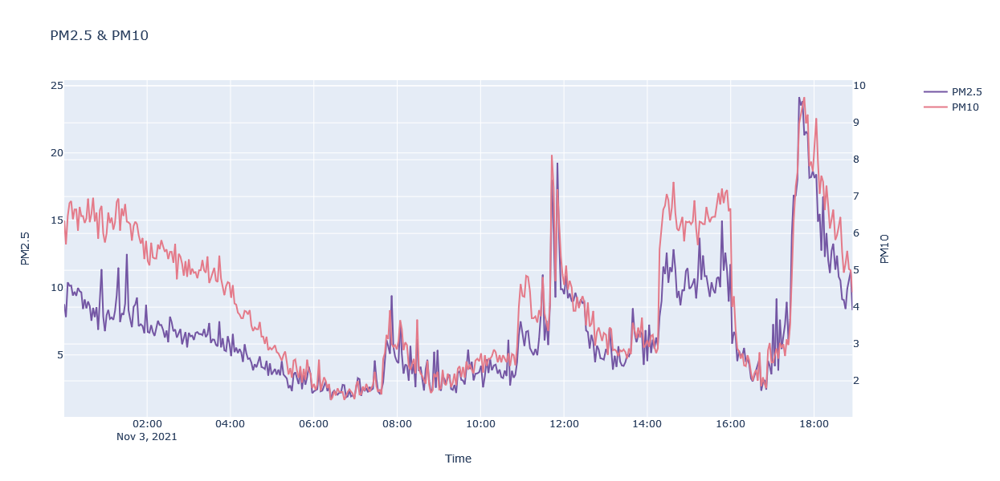

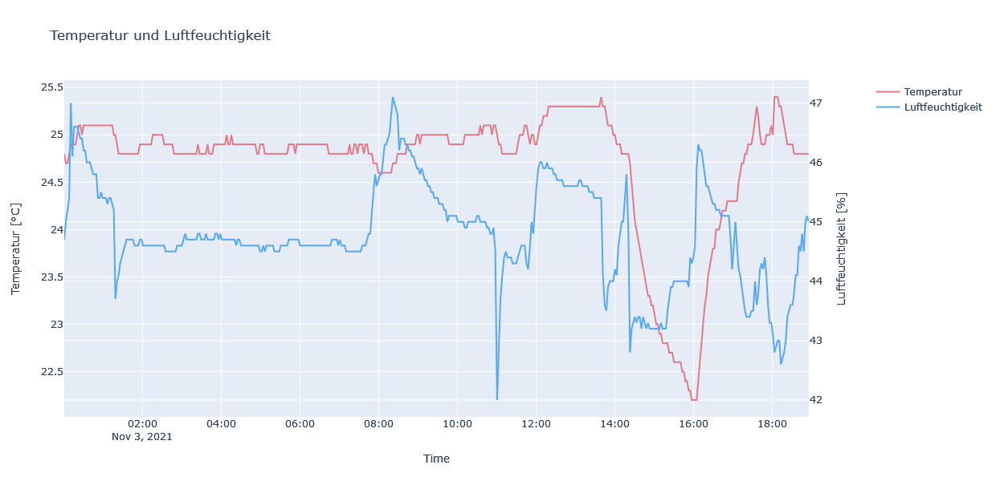

In [10]:
#plotting latest data of one day in plotly
import plotly.graph_objects as go
from plotly.subplots import make_subplots

def plotting(df):
    # Create figure with secondary y-axis
    fig = make_subplots(specs=[[{"secondary_y": True}]])

    # Add traces
    fig.add_trace(
        go.Scatter(x=df['Time'], y=df['SDS_P1'], name="PM2.5", line=dict(color='#7355A3')),
        secondary_y=False,

    )

    fig.add_trace(
        go.Scatter(x=df['Time'], y=df['SDS_P2'], name="PM10", line=dict(color='#E47988')),
        secondary_y=True,
    )

    # Add figure title
    fig.update_layout(
        title_text="PM2.5 & PM10",
        height=600
    )

    # Set x-axis title
    fig.update_xaxes(title_text="Time")

    # Set y-axes titles
    fig.update_yaxes(title_text="PM2.5", secondary_y=False)
    fig.update_yaxes(title_text="PM10", secondary_y=True)

    fig.show()
    
def plotting_temperature_humidity(df):
    # Create figure with secondary y-axis
    fig = make_subplots(specs=[[{"secondary_y": True}]])

    # Add traces
    fig.add_trace(
        go.Scatter(x=df['Time'], y=df['Temp'], name="Temperatur", line=dict(color='#E47988')),
        secondary_y=False,

    )

    fig.add_trace(
        go.Scatter(x=df['Time'], y=df['Humidity'], name="Luftfeuchtigkeit", line=dict(color='#53a7fc')),
        secondary_y=True,
    )

    # Add figure title
    fig.update_layout(
        title_text="Temperatur und Luftfeuchtigkeit",
        height=600
    )

    # Set x-axis title
    fig.update_xaxes(title_text="Time")

    # Set y-axes titles
    fig.update_yaxes(title_text="Temperatur [°C]", secondary_y=False)
    fig.update_yaxes(title_text="Luftfeuchtigkeit [%]", secondary_y=True)

    fig.show()
    
plotting(df)
plotting_temperature_humidity(df)

./week removed successfully
100% [..............................................................................] 23893 / 23893

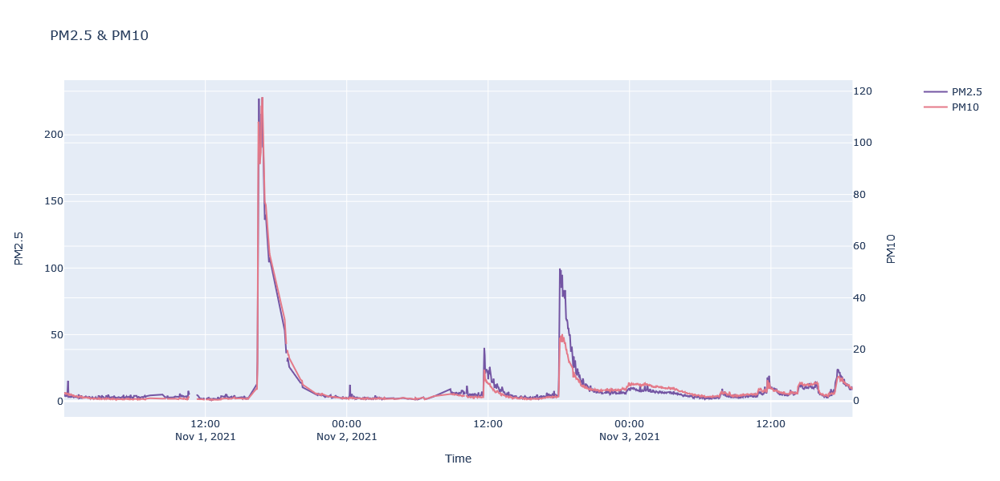

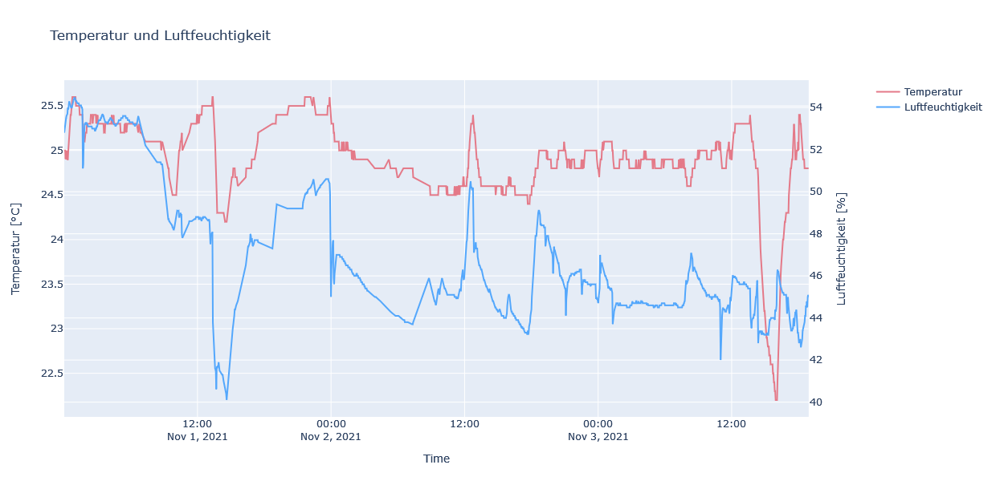

./month removed successfully
100% [..............................................................................] 23893 / 23893

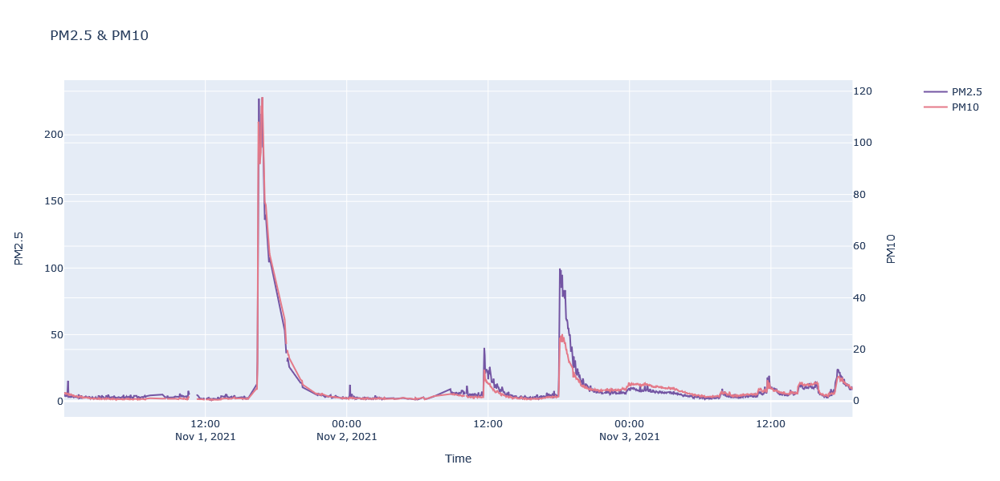

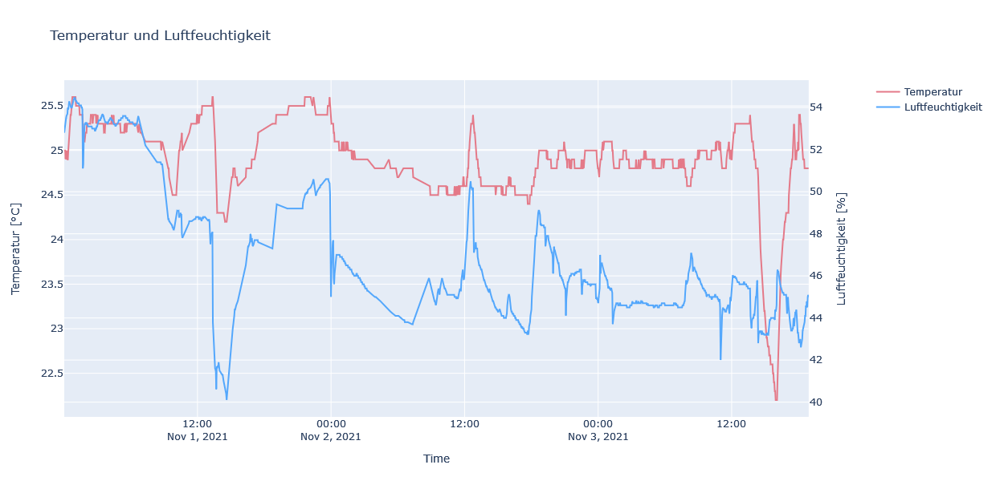

In [11]:
#WEEKLY and MONTHLY datas fetching
#Check if folder is already exists -> if yes then delete it
import shutil
import glob

def checkfolder(folder):
    path = './' + folder
    isdir = os.path.isdir(path)
    if isdir == True:
        shutil.rmtree(path)
        print("% s removed successfully" % path)
    else:
        print("Creating " + folder)

#download weekly datas
def download_datas(folder,timeinterval):
    path = './' + folder + ''
    os.mkdir(folder)
    for date in timeinterval:
        date=str(date)
        link = 'https://api-rrd.madavi.de/data_csv/csv-files/'+ date + '/data-esp8266-'+sensor_id+'-'+ date + '.csv'
        wget.download(link, path)
        
def join_csvfiles(folder):
    path = './' + folder + ''
    all_files = glob.glob(os.path.join(path, "*.csv"))
    df_from_each_file = (pd.read_csv(f, sep=';') for f in all_files)
    df_merged   = pd.concat(df_from_each_file, ignore_index=True)
    df_merged.to_csv("./"+folder+"/merged.csv")

checkfolder("week")      
download_datas("week",week)    
join_csvfiles("week")

df_week = pd.read_csv("./week/merged.csv",sep=",")

#plotting latest data of one week in plotly
df_week['Time'] = df_week['Time'].apply(convert_datetime)
plotting(df_week)
plotting_temperature_humidity(df_week)

#fetch and plot data of one month
checkfolder("month")
download_datas("month", month)
join_csvfiles("month")
df_month = pd.read_csv("./month/merged.csv",sep=",")
df_month['Time'] = df_month['Time'].apply(convert_datetime)
plotting(df_month)
plotting_temperature_humidity(df_month)

In [15]:
#find last month and export to string
last_month = int(str(today)[5:7]) #10
last_month = 12 if last_month == 1 else last_month-1
if len(str(last_month)) == 1:
    last_month = "0" + str(last_month) #09

last_month = str(last_month)
print(last_month)

10


In [16]:
#download data of last month
#https://api-rrd.madavi.de/data_csv/2021/10/data-esp8266-12776407-2021-10.zip
last_month_link = "https://api-rrd.madavi.de/data_csv/2021/"+last_month+"/data-esp8266-"+sensor_id+"-2021-"+last_month+".zip"
checkfolder(last_month)
path = './'+last_month
os.mkdir(last_month)
wget.download(last_month_link, path)

Creating 10
100% [............................................................................] 307021 / 307021

'./10/data-esp8266-12776407-2021-10.zip'

In [17]:
from zipfile import ZipFile 
dir = os.listdir(path)
file = dir[0]
path = path+"/"+file
# open the zip file in read mode
with ZipFile(path, 'r') as zip: 
    # extract all files to directory
    zip.extractall(last_month)
    
os.remove(path) #delete zip file

In [18]:
join_csvfiles(last_month)

In [19]:
df_last_month = pd.read_csv("./"+last_month+"/merged.csv",sep=",",low_memory=False)
df_last_month.head()

,Unnamed: 0,Time,durP1,ratioP1,P1,durP2,ratioP2,P2,SDS_P1,SDS_P2,...,BMP_pressure,BME280_temperature,BME280_humidity,BME280_pressure,Samples,Min_cycle,Max_cycle,Signal,HPM_P1,HPM_P2
0,0,2021/10/01 00:00:31,NaN,NaN,NaN,NaN,NaN,NaN,6.40,3.35,...,NaN,NaN,NaN,NaN,5049547,28,20025,-50,NaN,NaN
1,1,2021/10/01 00:02:56,NaN,NaN,NaN,NaN,NaN,NaN,5.22,2.78,...,NaN,NaN,NaN,NaN,5049623,28,20399,-44,NaN,NaN
2,2,2021/10/01 00:05:22,NaN,NaN,NaN,NaN,NaN,NaN,8.35,3.00,...,NaN,NaN,NaN,NaN,5050039,28,20472,-47,NaN,NaN
3,3,2021/10/01 00:07:49,NaN,NaN,NaN,NaN,NaN,NaN,8.15,3.15,...,NaN,NaN,NaN,NaN,5051385,28,20029,-45,NaN,NaN
4,4,2021/10/01 00:10:14,NaN,NaN,NaN,NaN,NaN,NaN,6.43,2.97,...,NaN,NaN,NaN,NaN,5050198,28,20055,-47,NaN,NaN


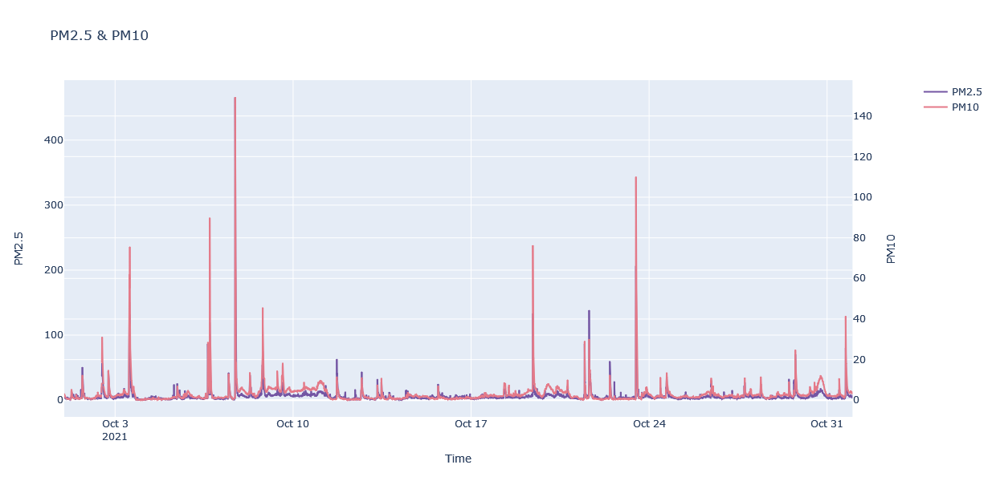

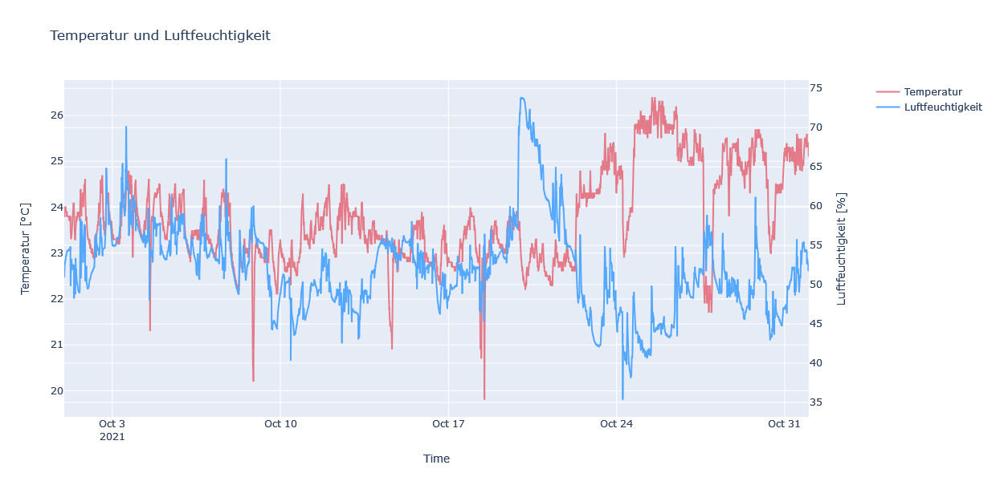

In [20]:
df_last_month['Time'] = pd.to_datetime(df_last_month['Time'], errors='coerce')
plotting(df_last_month)
plotting_temperature_humidity(df_last_month)

In [21]:
import requests_html 

months = []
with requests_html.HTMLSession() as s:
    try:
        r = s.get('https://api-rrd.madavi.de/csvfiles.php?sensor=esp8266-'+sensor_id)
        links = r.html.links
        for link in links:
            if link[-3:] == "zip":
                months.append(link)
    except:
        pass
        
print(months)

['data_csv/2021/09/data-esp8266-12776407-2021-09.zip', 'data_csv/2021/05/data-esp8266-12776407-2021-05.zip', 'data_csv/2020/12/data-esp8266-12776407-2020-12.zip', 'data_csv/2021/07/data-esp8266-12776407-2021-07.zip', 'data_csv/2021/10/data-esp8266-12776407-2021-10.zip', 'data_csv/2021/08/data-esp8266-12776407-2021-08.zip']


In [22]:
#download all zip files of past months
checkfolder("all")
path = './all'
os.mkdir("all")

for link in months:
    download_link = "https://api-rrd.madavi.de/"+link
    wget.download(download_link, path)
    

./all removed successfully
100% [............................................................................] 330452 / 330452

In [23]:
#extract zip files
days = os.listdir("./all")
for day in days:
    path="./all/"+day
    with ZipFile(path, 'r') as zip: 
        # extract all files to directory
        zip.extractall("all")
    os.remove(path)

#download datas of this month to the all-folder
for date in month:
    path = './all'
    date=str(date)
    link = 'https://api-rrd.madavi.de/data_csv/csv-files/'+ date + '/data-esp8266-'+sensor_id+'-'+ date + '.csv'
    wget.download(link, path)

100% [..............................................................................] 23893 / 23893

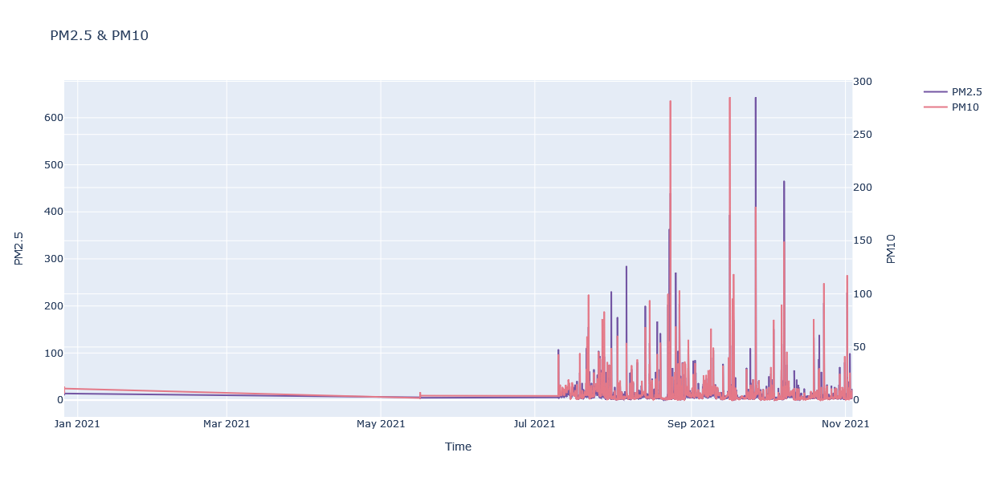

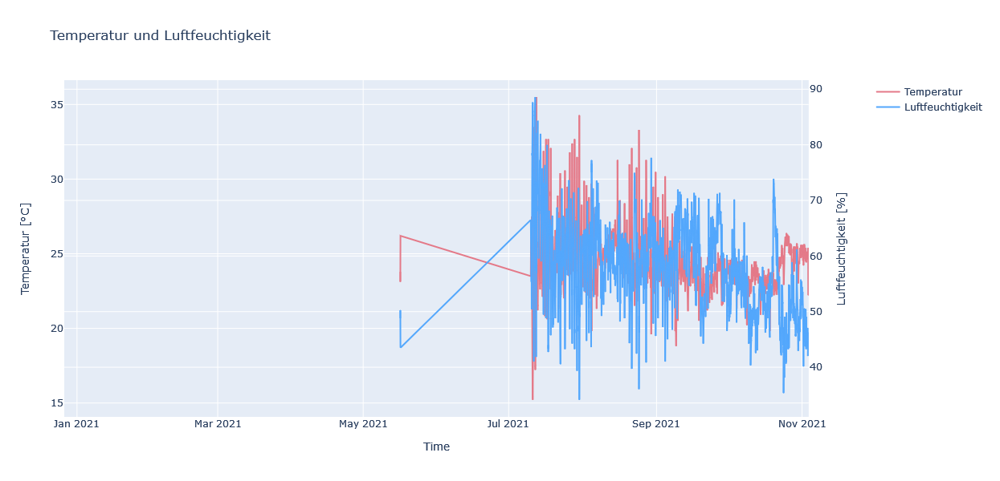

In [24]:
join_csvfiles("all")
df_all = pd.read_csv("./all/merged.csv",sep=",")
df_all['Time'] = df_all['Time'].apply(convert_datetime)
plotting(df_all)
plotting_temperature_humidity(df_all)